## Model Selection & Setup

In [3]:
#Install YOLOv8 and OpenCV
!pip install ultralytics opencv-python numpy

#Import libraries
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # For displaying images in Colab

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 977.3/977.3 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 90.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 74.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 40.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 56.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
# Load YOLOv8n (nano version - lightweight & fast)
model = YOLO('yolov8n.pt')  # Automatically downloads the model

100%|██████████| 6.25M/6.25M [00:00<00:00, 17.2MB/s]


--2025-04-03 11:55:49--  https://ultralytics.com/images/bus.jpg
Resolving ultralytics.com (ultralytics.com)... 75.2.70.75, 99.83.190.102
Connecting to ultralytics.com (ultralytics.com)|75.2.70.75|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.ultralytics.com/images/bus.jpg [following]
--2025-04-03 11:55:50--  https://www.ultralytics.com/images/bus.jpg
Resolving www.ultralytics.com (www.ultralytics.com)... 104.18.40.102, 172.64.147.154, 2606:4700:4400::6812:2866, ...
Connecting to www.ultralytics.com (www.ultralytics.com)|104.18.40.102|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://github.com/ultralytics/assets/releases/download/v0.0.0/bus.jpg [following]
--2025-04-03 11:55:50--  https://github.com/ultralytics/assets/releases/download/v0.0.0/bus.jpg
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP reques

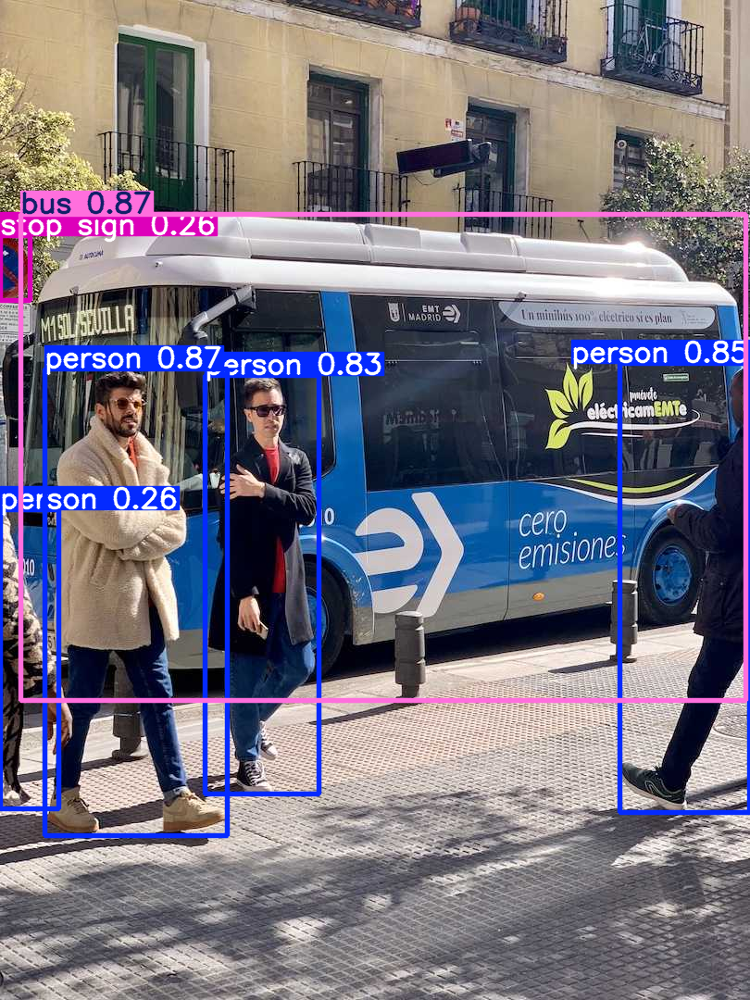

In [ ]:
# Download a test image (bus.jpg from Ultralytics)
!wget https://ultralytics.com/images/bus.jpg -O test_image.jpg

# Run detection
results = model('test_image.jpg')

# Display results with bounding boxes
for r in results:
    im_array = r.plot()  # Draws bounding boxes & labels
    cv2_imshow(im_array)  # Shows the image in Colab

In [ ]:
# Get class names (COCO dataset)
class_names = model.names
print("YOLOv8 can detect these objects:")
print(class_names)

YOLOv8 can detect these objects:
{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboar

## Real-Time Detection

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from IPython.display import HTML, display
import IPython

In [ ]:

# Webcam setup
def show_webcam():
    display(HTML("""
    <video id="video" width="640" height="480" autoplay></video>
    <button id="stopButton">Stop Detection</button>
    <script>
    const video = document.getElementById('video');
    const stopButton = document.getElementById('stopButton');
    let stream;

    // Start webcam
    navigator.mediaDevices.getUserMedia({video: true})
        .then(s => { stream = s; video.srcObject = stream; });

    // Stop function
    stopButton.onclick = () => {
        stream.getTracks().forEach(track => track.stop());
        document.getElementById('output').innerHTML = 'Webcam stopped';
    };

    // Capture frame for Python
    function capture() {
        const canvas = document.createElement('canvas');
        canvas.width = video.videoWidth;
        canvas.height = video.videoHeight;
        canvas.getContext('2d').drawImage(video, 0, 0);
        return canvas.toDataURL('image/jpeg', 0.8);
    }
    </script>
    """))

show_webcam()

# Detection loop
try:
    while True:
        # Get frame from JavaScript
        frame_data = IPython.display.eval_js("capture()")
        frame = b64decode(frame_data.split(',')[1])
        frame = cv2.imdecode(np.frombuffer(frame, dtype=np.uint8), cv2.IMREAD_COLOR)

        # Run detection
        results = model(frame)
        annotated_frame = results[0].plot()  # Draw detections

        # Show output
        cv2_imshow(annotated_frame)

        # Add small delay
        if cv2.waitKey(100) & 0xFF == ord('q'):
            break

except Exception as e:
    print(f"Stopped: {e}")
finally:
    # Cleanup
    display(HTML("""
    <script>
    if (typeof stream !== 'undefined') {
        stream.getTracks().forEach(track => track.stop());
    }
    </script>
    <div id="output">Webcam released</div>
    """))
    cv2.destroyAllWindows()

Stopped: module 'IPython.display' has no attribute 'eval_js'


In [ ]:
!pip install ultralytics opencv-python numpy
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [4]:
from google.colab import files

# This will prompt you to upload a file
uploaded = files.upload()

# Get the first uploaded filename
video_path = next(iter(uploaded.keys()))

# This will print the uploaded filename
print(f"Using video file: {video_path}")

Saving object_video2 - Made with Clipchamp.mp4 to object_video2 - Made with Clipchamp.mp4
Using video file: object_video2 - Made with Clipchamp.mp4


In [11]:
!ls -lh

total 7.6M
-rw-r--r-- 1 root root 1.3M Apr  3 18:03 'object_video2 - Made with Clipchamp.mp4'
drwxr-xr-x 1 root root 4.0K Apr  2 13:35  sample_data
-rw-r--r-- 1 root root 6.3M Apr  3 17:59  yolov8n.pt


In [13]:
!ffmpeg -i 'object_video2 - Made with Clipchamp.mp4' -vcodec libx265 -crf 28 compressed_video.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [14]:
!ls -lh compressed.mp4

ls: cannot access 'compressed.mp4': No such file or directory


100%|██████████| 6.25M/6.25M [00:00<00:00, 67.4MB/s]



0: 640x384 (no detections), 335.0ms
Speed: 21.8ms preprocess, 335.0ms inference, 11.6ms postprocess per image at shape (1, 3, 640, 384)


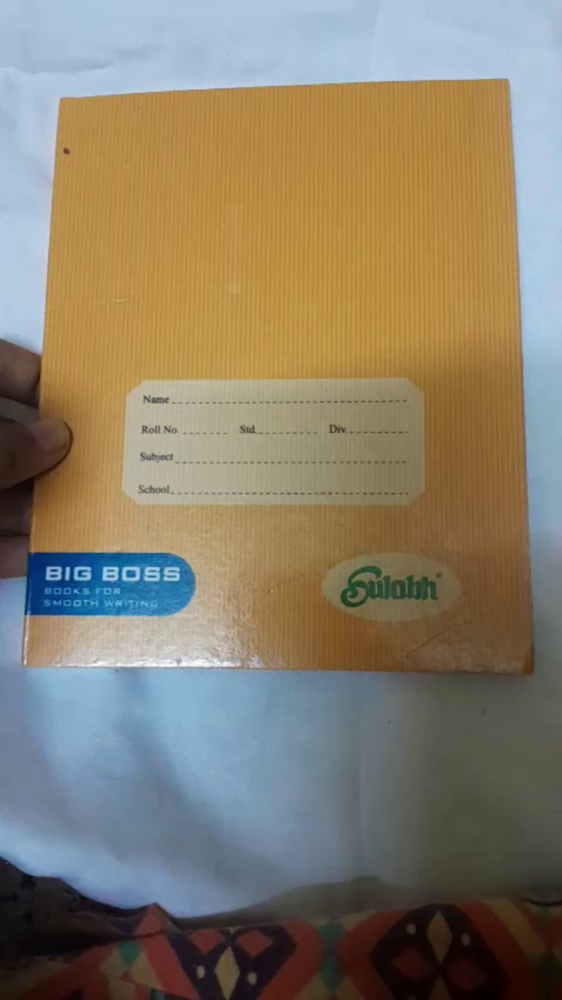


0: 640x384 (no detections), 209.5ms
Speed: 5.0ms preprocess, 209.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 384)


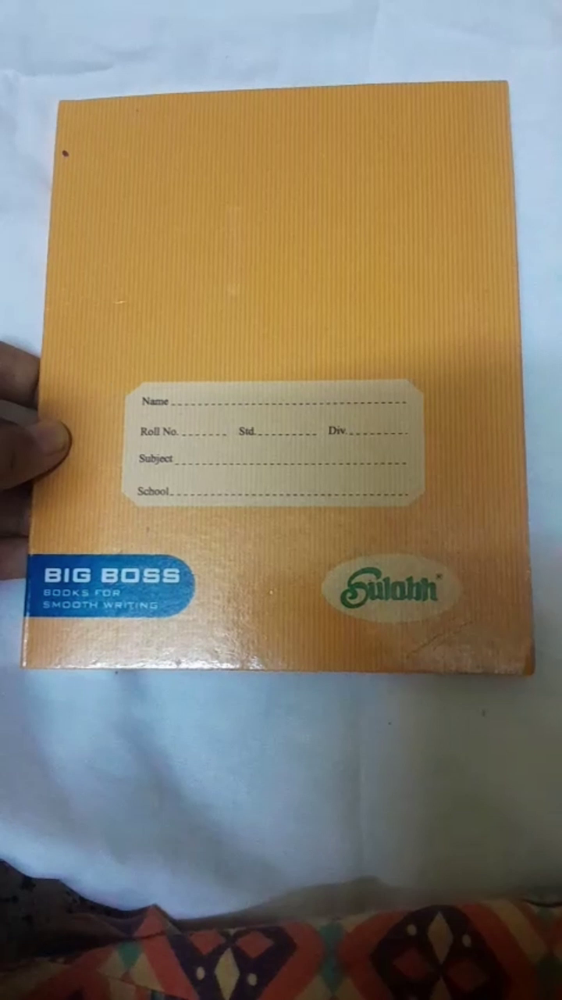


0: 640x384 (no detections), 230.0ms
Speed: 3.1ms preprocess, 230.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 384)


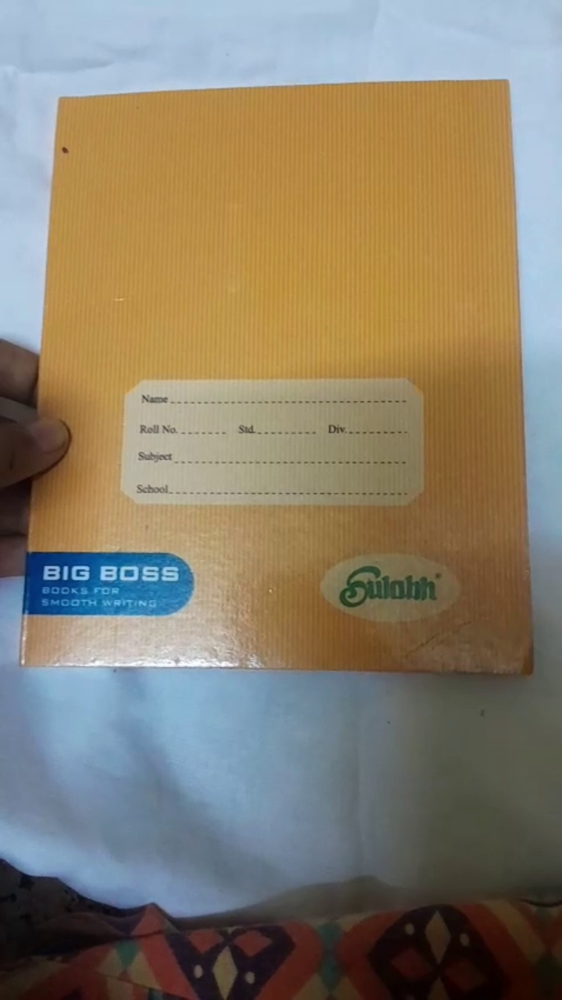


0: 640x384 (no detections), 233.4ms
Speed: 3.1ms preprocess, 233.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)


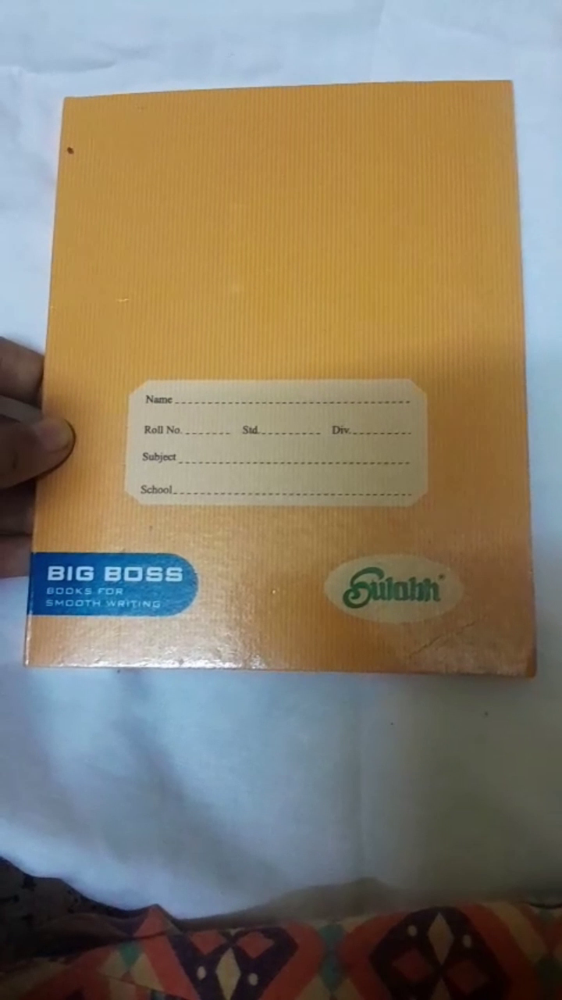


0: 640x384 (no detections), 230.8ms
Speed: 5.1ms preprocess, 230.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


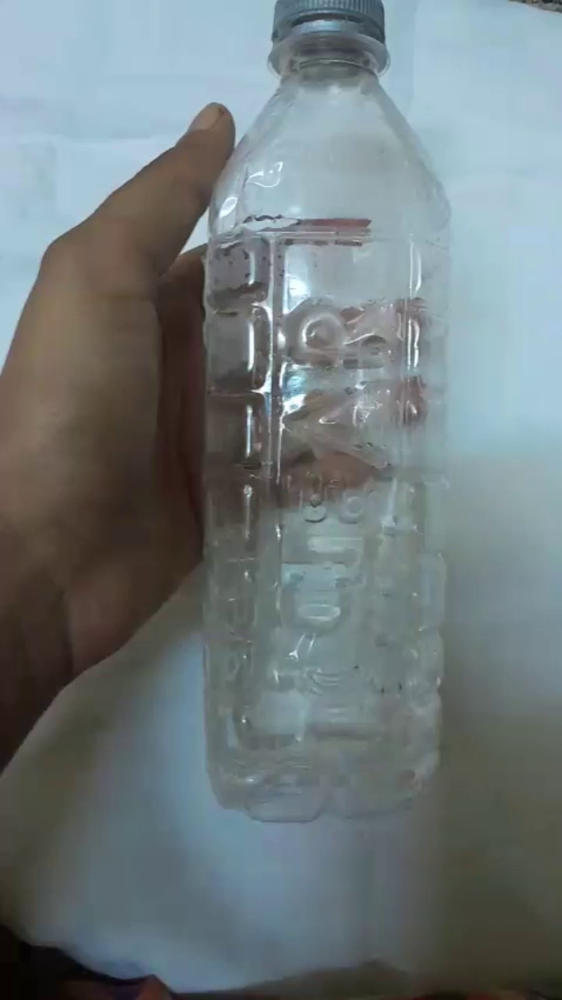


0: 640x384 (no detections), 228.3ms
Speed: 3.7ms preprocess, 228.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


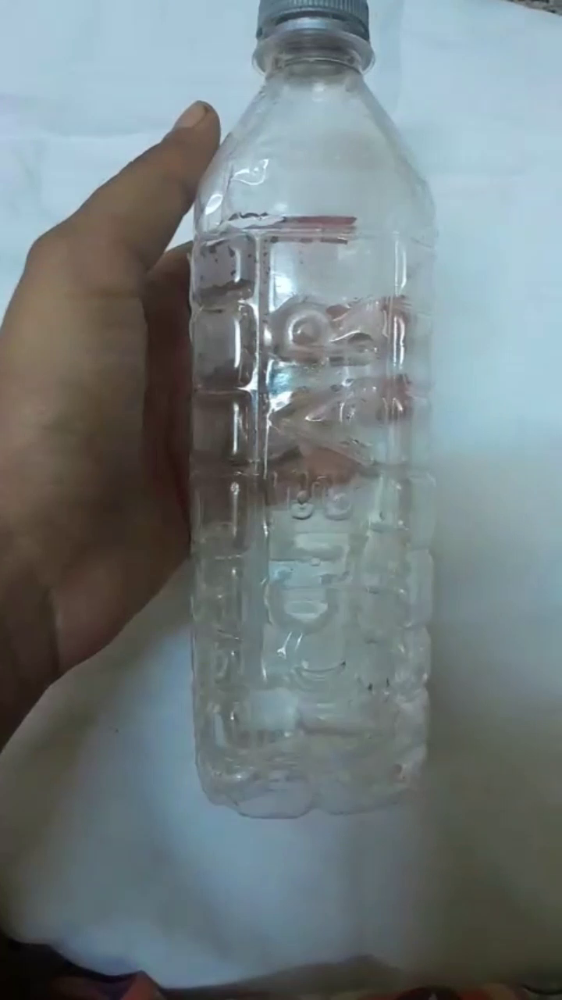


0: 640x384 1 bottle, 229.0ms
Speed: 3.2ms preprocess, 229.0ms inference, 24.1ms postprocess per image at shape (1, 3, 640, 384)


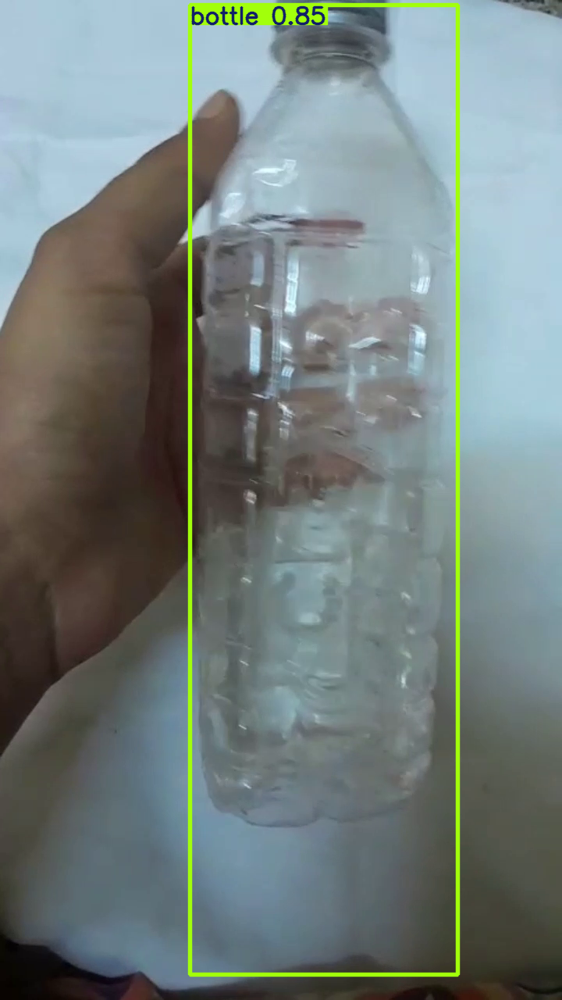


0: 640x384 (no detections), 242.5ms
Speed: 3.2ms preprocess, 242.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


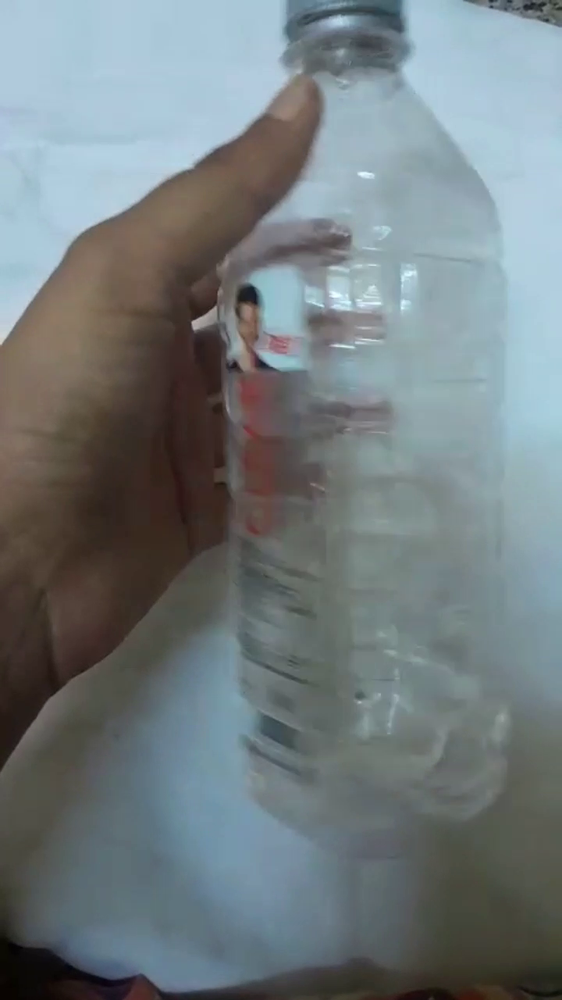


0: 640x384 (no detections), 234.0ms
Speed: 4.5ms preprocess, 234.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


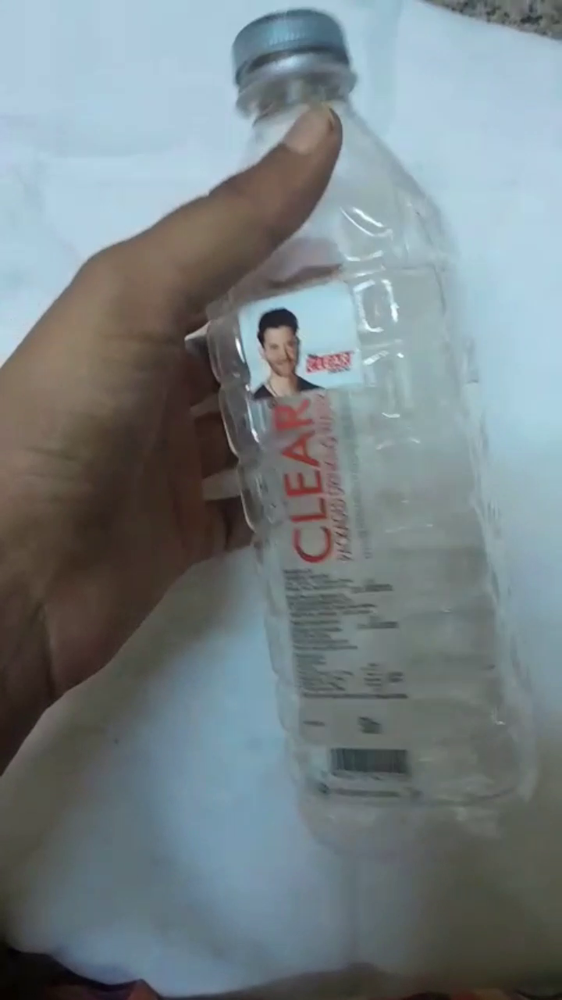


0: 640x384 (no detections), 233.6ms
Speed: 3.1ms preprocess, 233.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


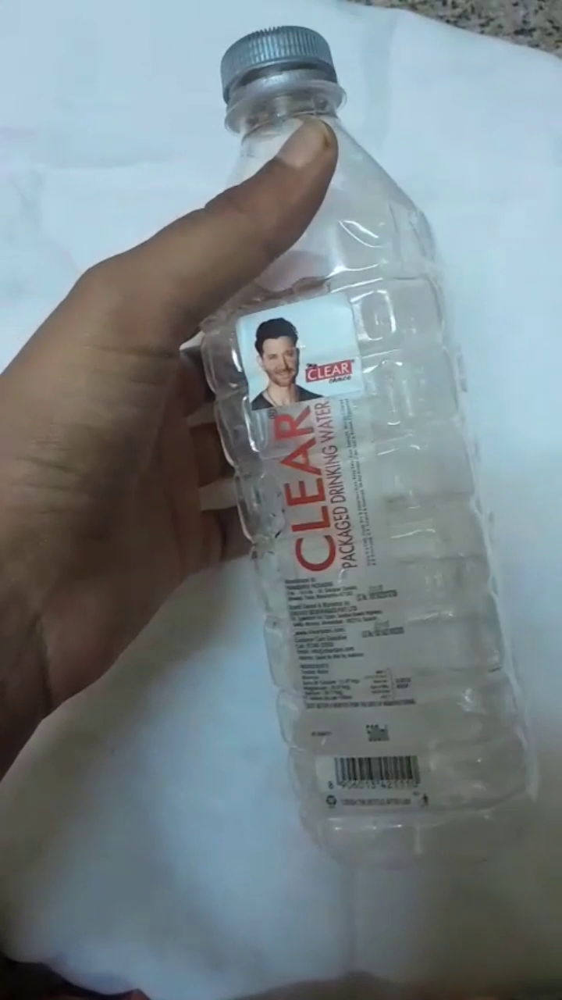


0: 640x384 (no detections), 233.6ms
Speed: 8.9ms preprocess, 233.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


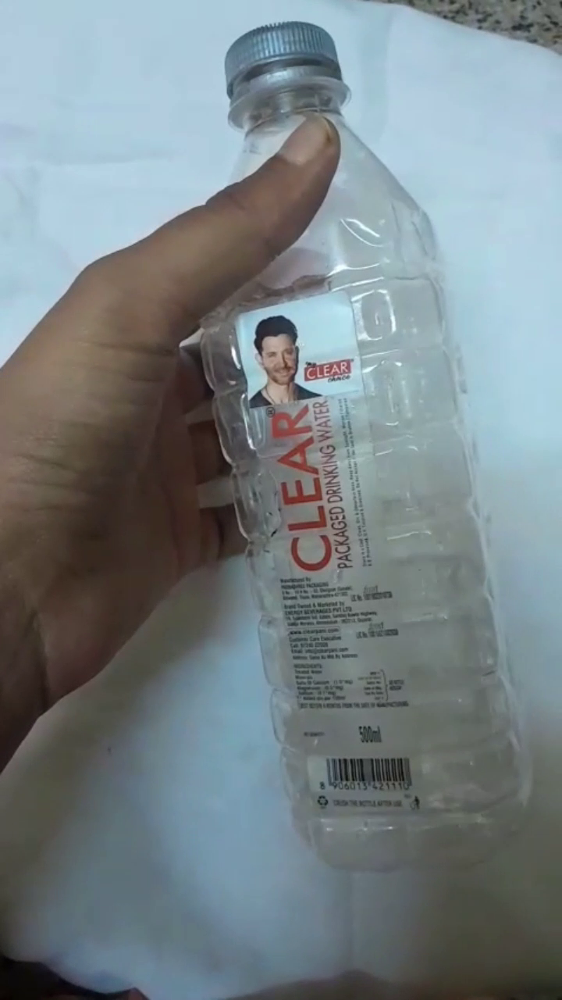


0: 640x384 (no detections), 233.9ms
Speed: 3.8ms preprocess, 233.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


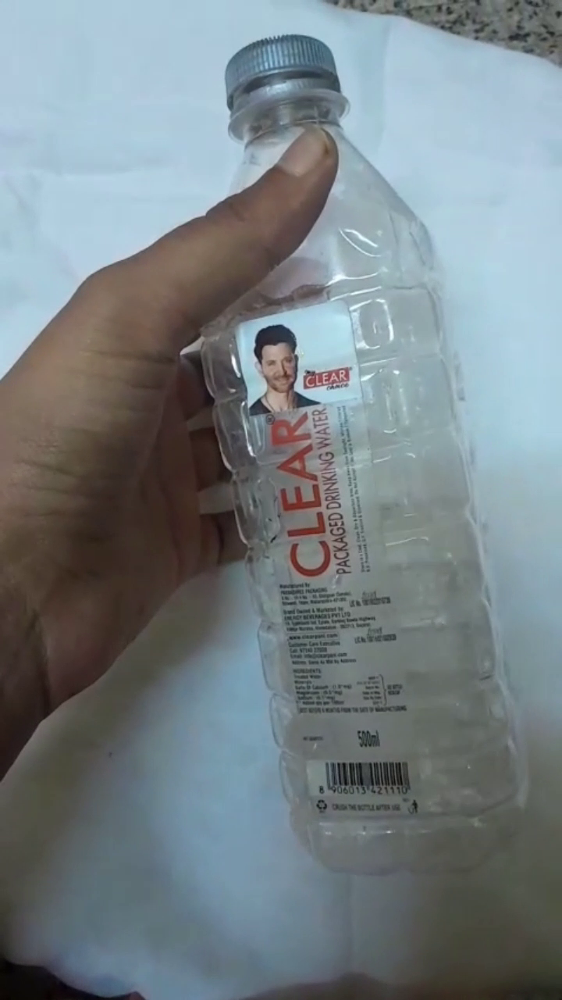


0: 640x384 (no detections), 309.6ms
Speed: 5.4ms preprocess, 309.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


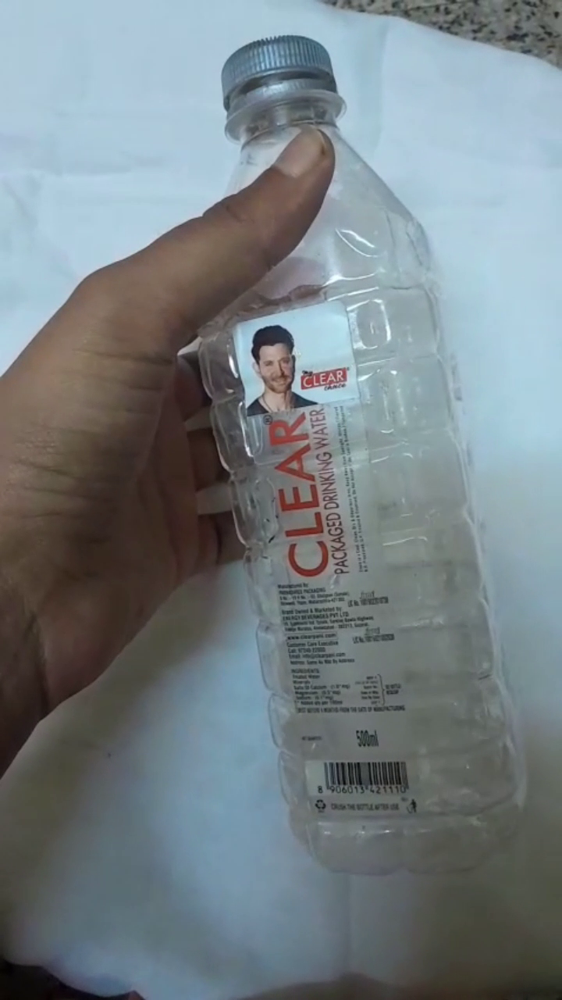


0: 640x384 (no detections), 237.1ms
Speed: 5.4ms preprocess, 237.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


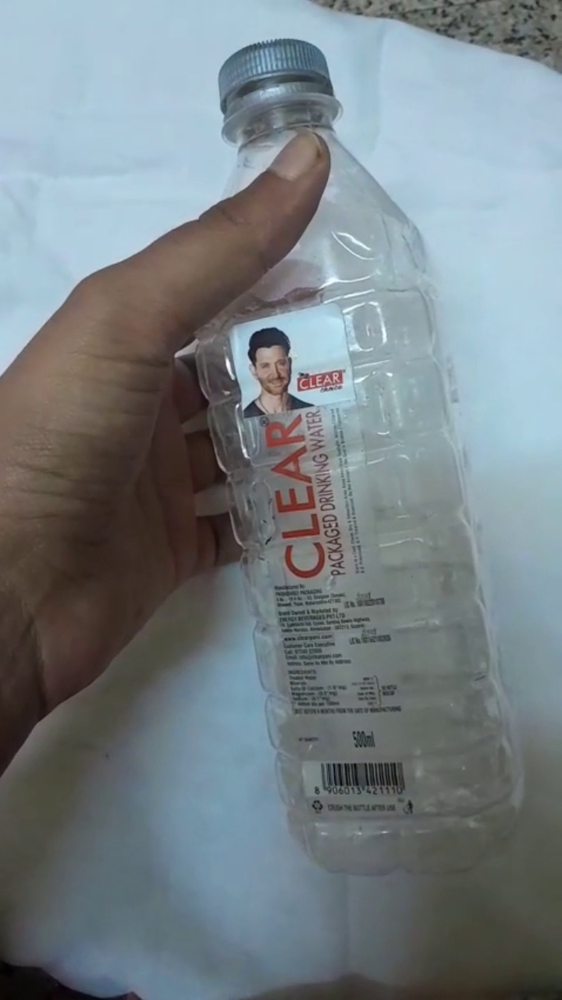


0: 640x384 (no detections), 229.8ms
Speed: 5.7ms preprocess, 229.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


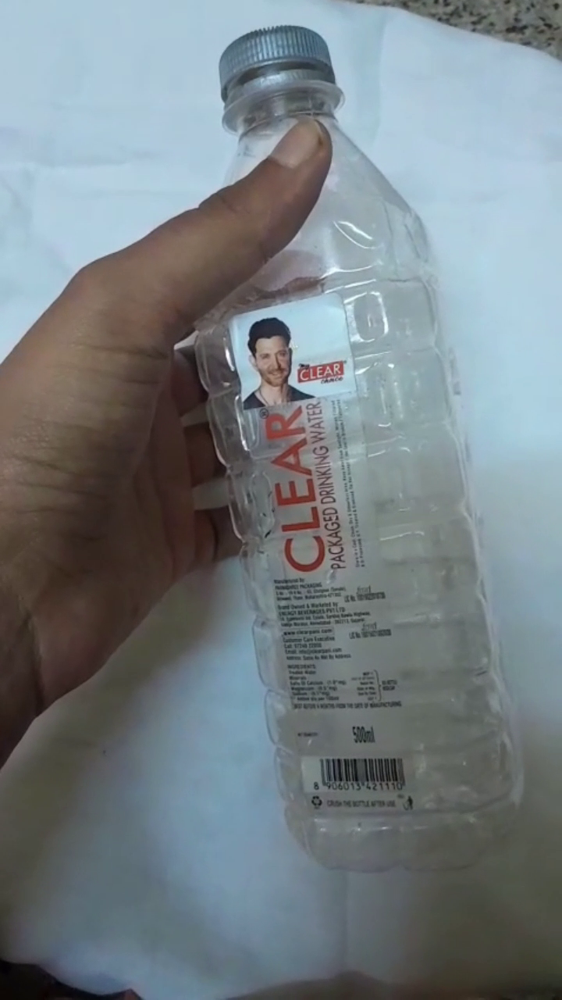


0: 640x384 (no detections), 283.4ms
Speed: 3.1ms preprocess, 283.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


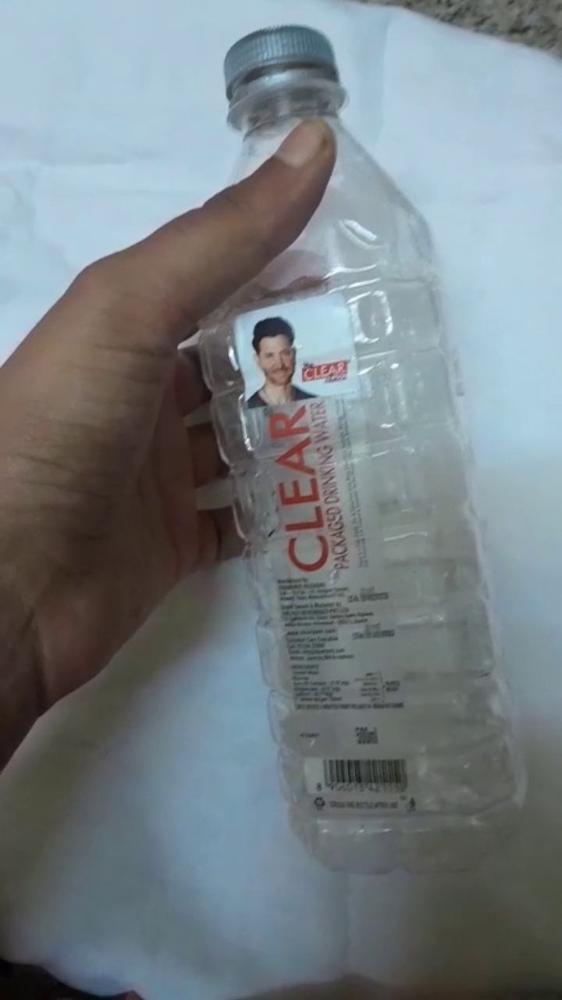


0: 640x384 (no detections), 266.5ms
Speed: 3.0ms preprocess, 266.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


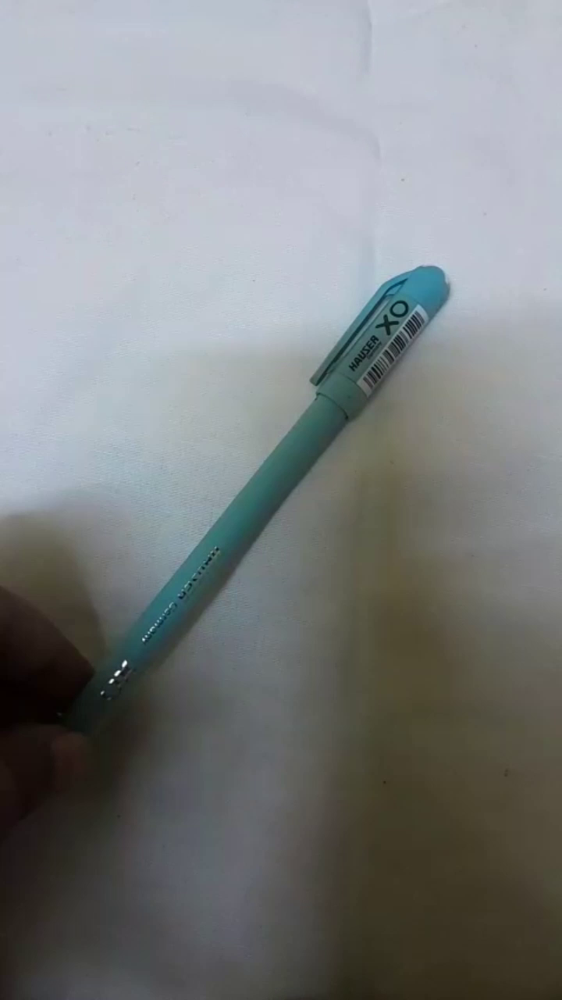


0: 640x384 (no detections), 276.1ms
Speed: 3.5ms preprocess, 276.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


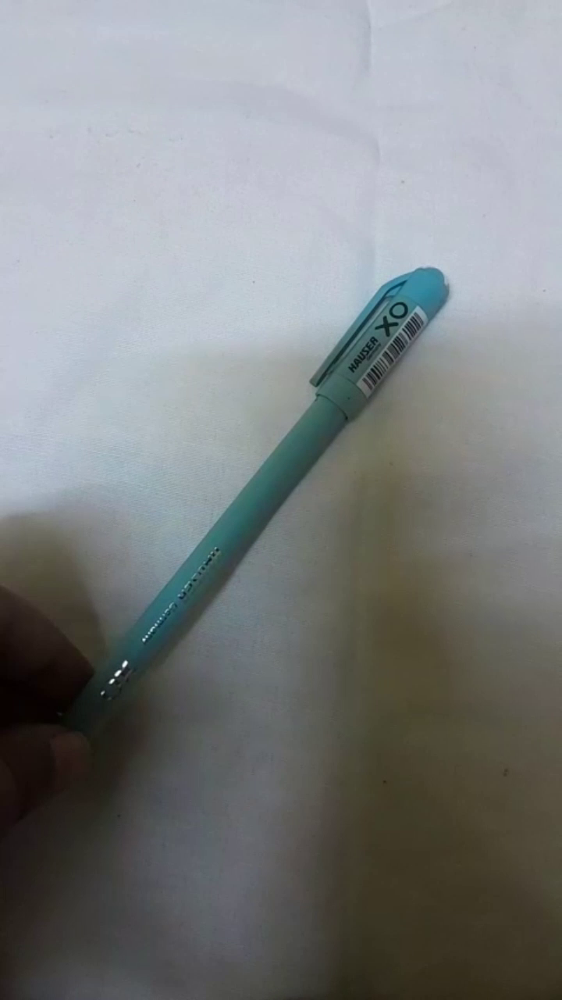


0: 640x384 (no detections), 240.9ms
Speed: 3.0ms preprocess, 240.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


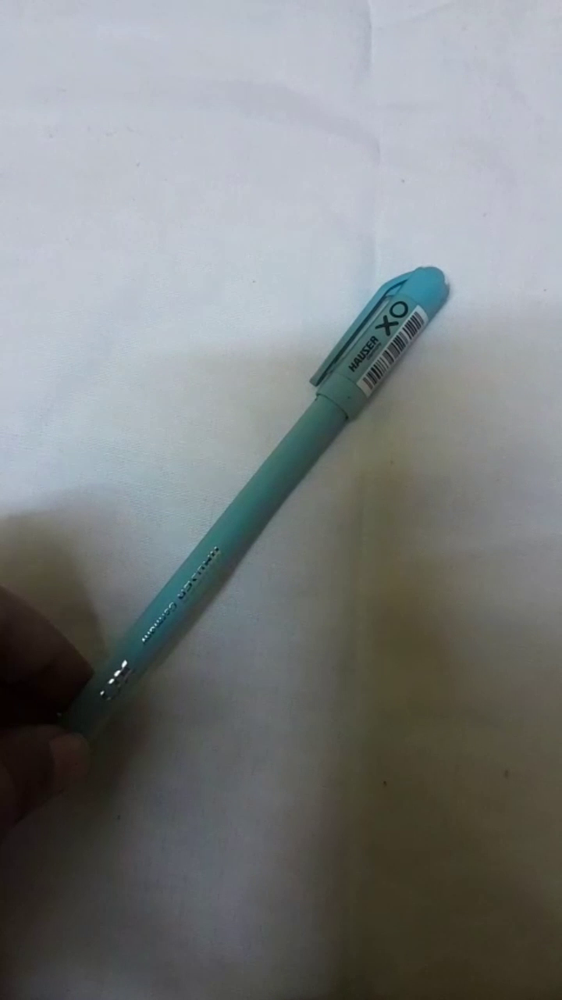


0: 640x384 (no detections), 243.1ms
Speed: 3.1ms preprocess, 243.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


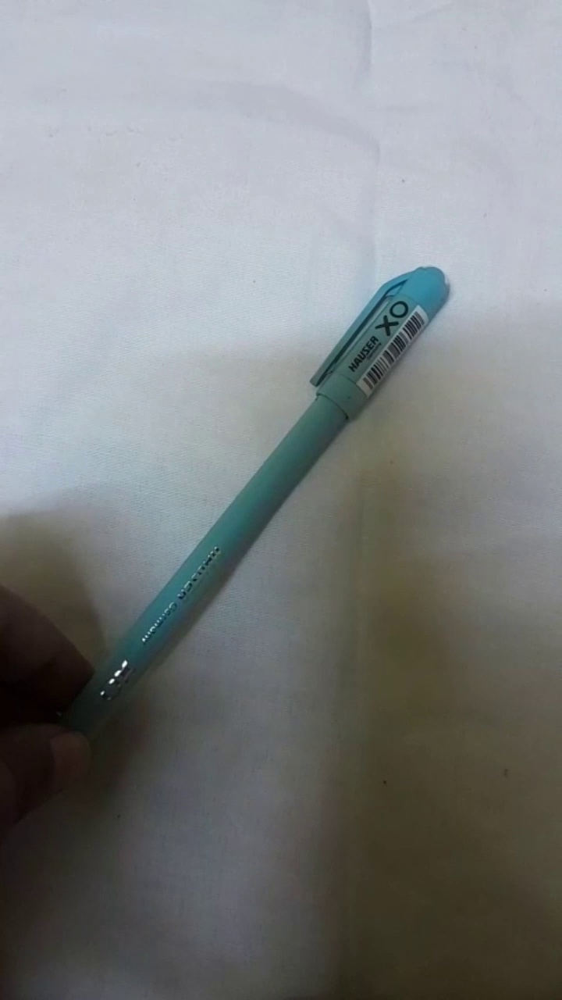


0: 640x384 (no detections), 277.0ms
Speed: 6.7ms preprocess, 277.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


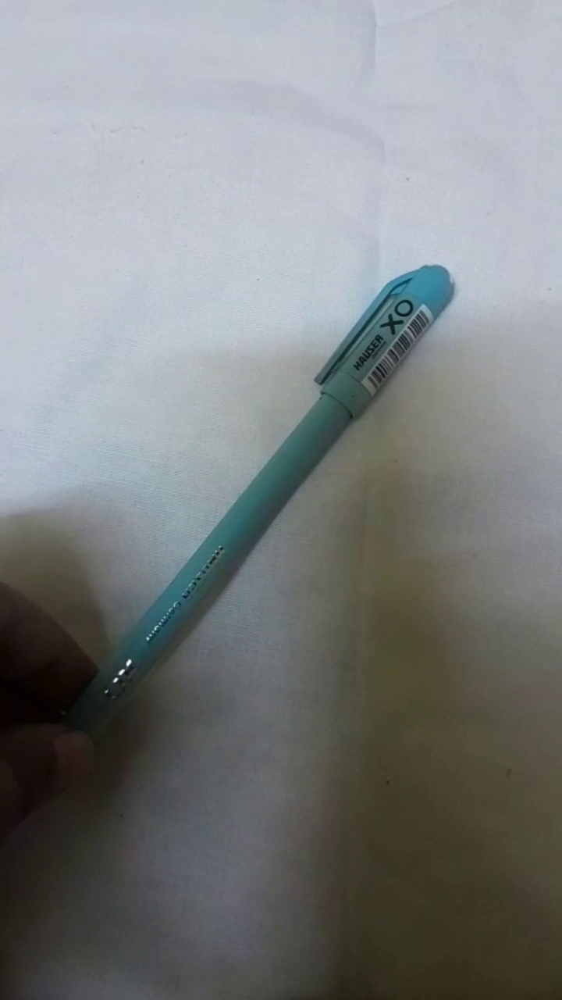


0: 640x384 (no detections), 279.8ms
Speed: 5.1ms preprocess, 279.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


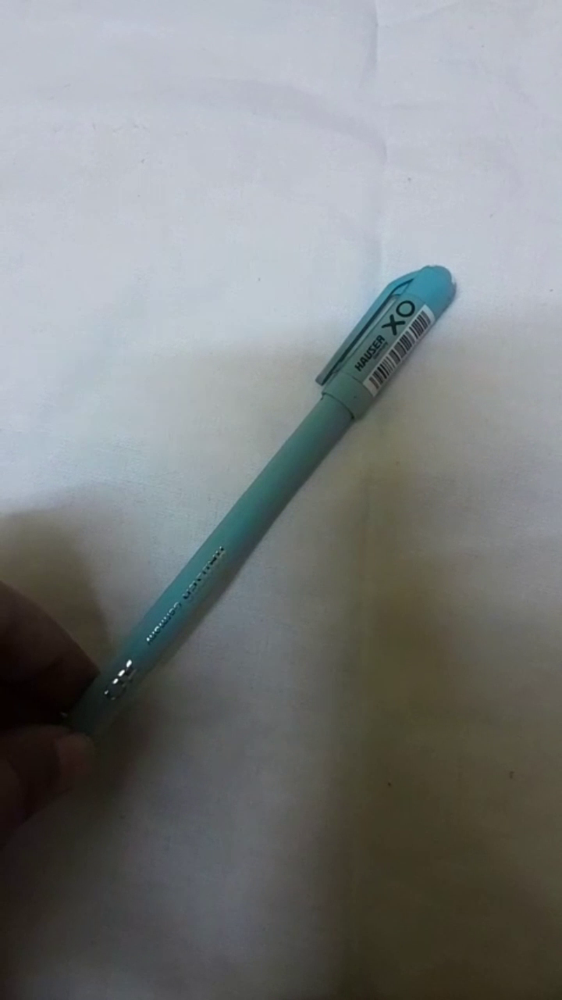


0: 640x384 1 cup, 269.5ms
Speed: 3.2ms preprocess, 269.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


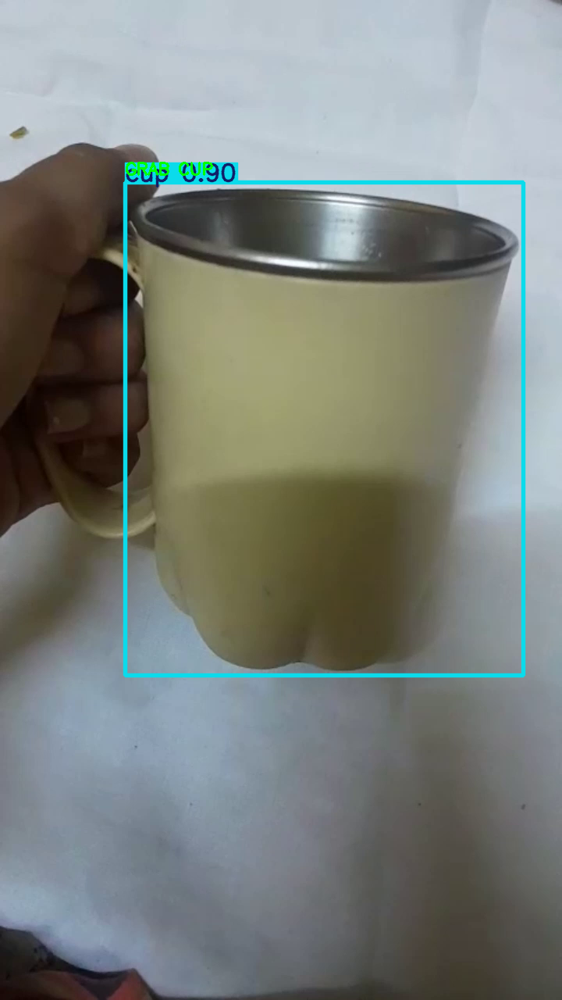


0: 640x384 1 cup, 312.3ms
Speed: 3.4ms preprocess, 312.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


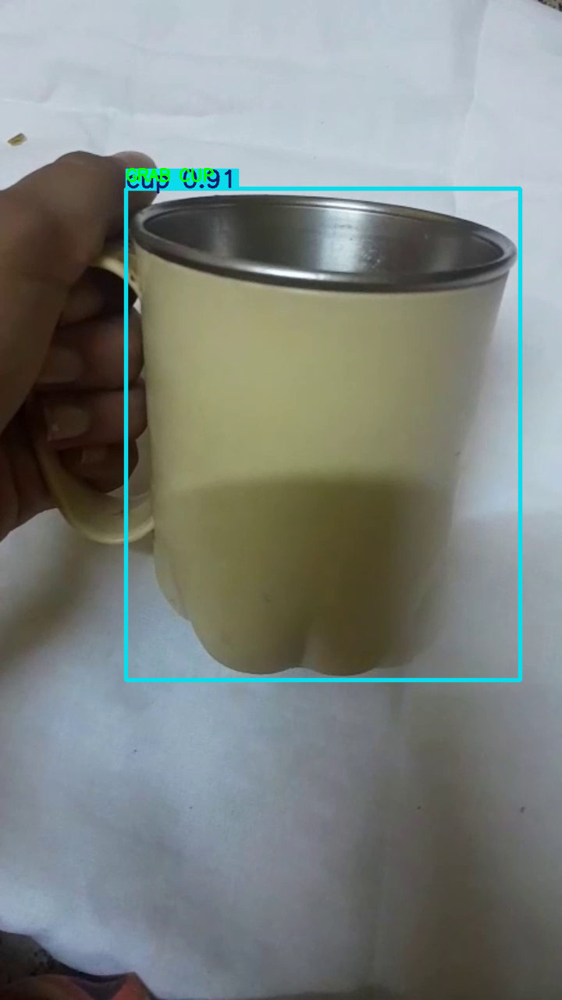


0: 640x384 1 cup, 275.3ms
Speed: 3.2ms preprocess, 275.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)


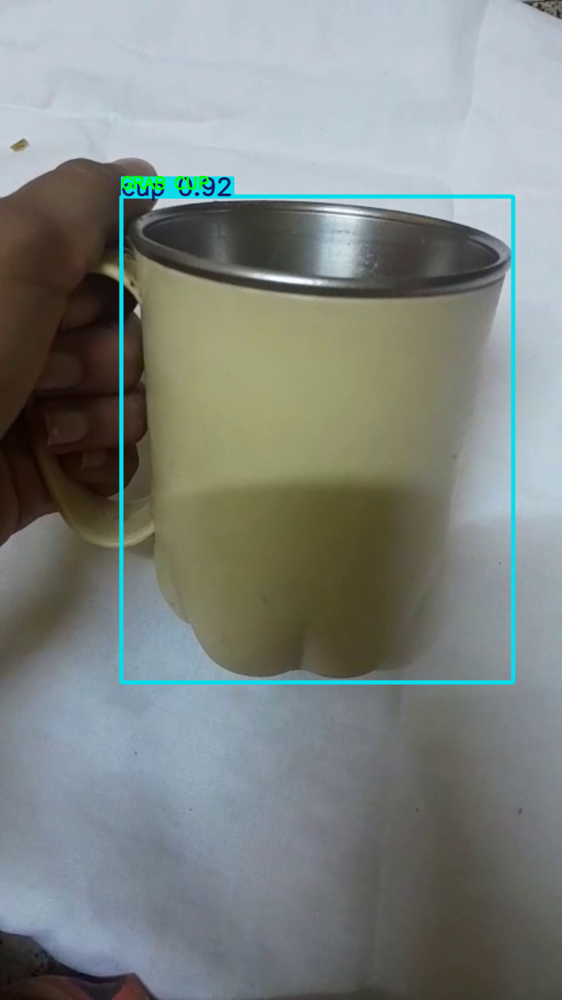


0: 640x384 1 cup, 308.4ms
Speed: 3.2ms preprocess, 308.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)


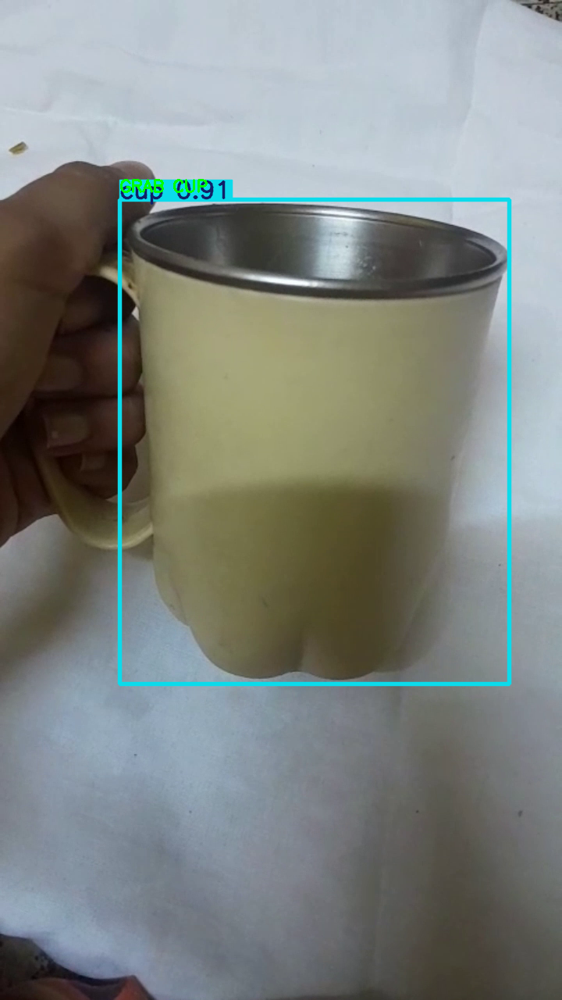


0: 640x384 1 cup, 289.9ms
Speed: 5.1ms preprocess, 289.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)


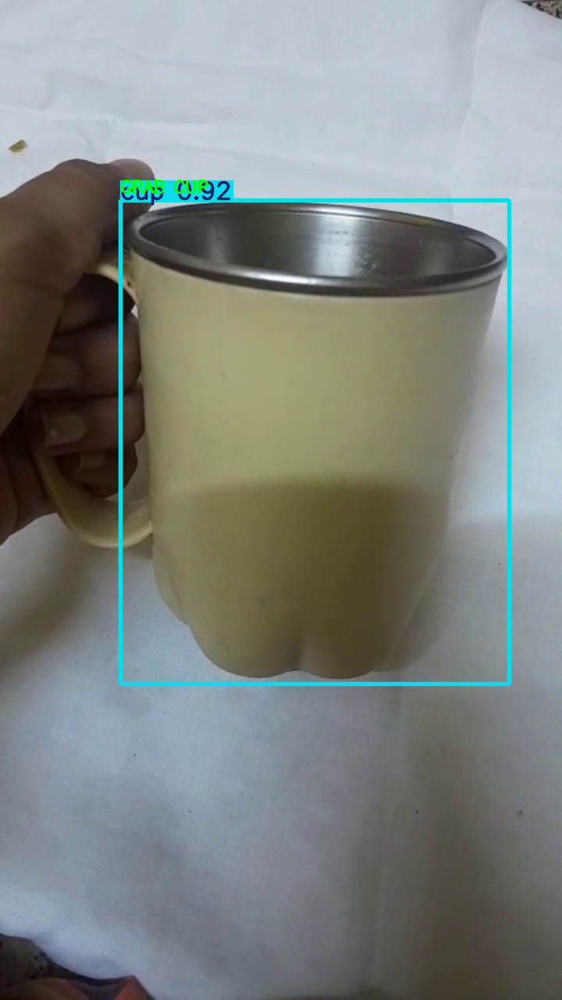


0: 640x384 1 cup, 293.9ms
Speed: 3.2ms preprocess, 293.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


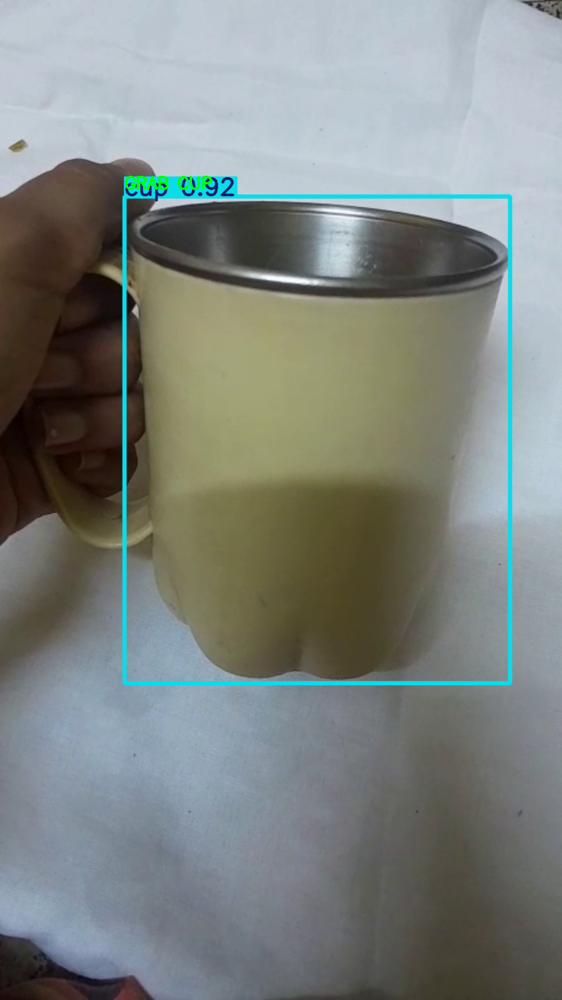

Detection completed successfully!


In [5]:
from ultralytics import YOLO
import cv2
from google.colab.patches import cv2_imshow

# Initialize model (auto-downloads if needed)
model = YOLO('yolov8n.pt')

# Define objects relevant for robotics (COCO class IDs)
ROBOTIC_TARGETS = {
    39: 'bottle',
    41: 'cup',
    66: 'pen',
    73: 'book'
}

# Process video
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Detect only robotic targets with high confidence
    results = model(frame, classes=list(ROBOTIC_TARGETS.keys()), conf=0.7)

    # Visualize with robotic action labels
    annotated_frame = results[0].plot()

    # Add robotic command annotations
    for box in results[0].boxes:
        obj_type = ROBOTIC_TARGETS[int(box.cls)]
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        cv2.putText(annotated_frame,
                   f"GRAB {obj_type.upper()}",
                   (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX,
                   0.7, (0,255,0), 2)

    cv2_imshow(annotated_frame)
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

cap.release()
print("Detection completed successfully!")

## Coordinate Extraction for Robotics

In [6]:
# This extracts coordinates for robotic arm control
for result in results:
    for box in result.boxes:
        class_id = int(box.cls)
        coords = box.xyxy[0].tolist()  # [x1,y1,x2,y2] in pixels
        print(f"Detected {ROBOTIC_TARGETS[class_id]} at position {coords}")
        # robot_arm.move_to(coords)  # Would be used with PyBullet

Detected cup at position [159.64044189453125, 251.833984375, 653.90966796875, 874.9130859375]
